In [1]:
import pandas as pd
import sys


sys.path.append('../../')
from src.plot_helpers import plot_experiment_range,plot_correlation_matrix
from src.transform import transform_diff_avg,load_json

ref_cols = load_json("../../json/locations.json")["ref_palas"]

## Load data

In [2]:
df = pd.read_csv('../../data/clean_data/all_sensors.csv',index_col=0,parse_dates=True)
df

/tmp/ipykernel_2069360/2544046345.py:1: DtypeWarning: Columns (6,26) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('../../data/clean_data/all_sensors.csv',index_col=0,parse_dates=True)


,aqi_palas,averaging,cn,co,co2,dcn,formaldehyde,global_error,humidity,indoor_nox_index,...,temperature,tvoc,tvoc_mg,tvoc_ppb,volume_flow,x10_dcn,x16_dcn,x50_dcn,x84_dcn,x90_dcn
2024-10-11 13:24:18,NaN,NaN,NaN,NaN,566.00,NaN,3.0,NaN,58.00,NaN,...,20.50,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:33:57,NaN,NaN,NaN,NaN,528.00,NaN,11.0,NaN,58.00,NaN,...,21.00,87.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:43:57,NaN,NaN,NaN,NaN,596.00,NaN,36.0,NaN,57.00,NaN,...,22.20,103.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:44:34,NaN,NaN,NaN,NaN,675.00,NaN,42.0,NaN,57.00,NaN,...,22.70,103.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:54:27,NaN,NaN,NaN,NaN,701.00,NaN,41.0,NaN,57.00,NaN,...,23.00,102.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-11-05 16:17:00,56.47,60.0,1112.10,NaN,996.77,->,NaN,0.0,51.54,NaN,...,22.17,NaN,0.06,NaN,1.0,0.19,0.2,0.24,0.3,0.34
2024-11-05 16:18:00,58.78,60.0,1140.10,NaN,1025.73,->,NaN,0.0,50.25,NaN,...,22.78,NaN,0.09,NaN,1.0,0.19,0.2,0.24,0.3,0.33
2024-11-05 16:19:00,60.80,60.0,1142.41,NaN,1034.32,->,NaN,0.0,51.30,NaN,...,23.02,NaN,0.09,NaN,1.0,0.19,0.2,0.24,0.3,0.33
2024-11-05 16:20:00,62.53,60.0,1154.18,NaN,1011.70,->,NaN,0.0,48.37,NaN,...,23.13,NaN,0.07,NaN,1.0,0.19,0.2,0.24,0.3,0.33


In [3]:
df_ref = df.loc[df['sensor'] == 'ref_sensor'][ref_cols]
df_ref

,pm_1.0,pm_2.5,pm_4.0,pm_10,pm_tot,co2,tvoc_mg,cn,m1_0,m2_0,...,x90_dcn,temperature,pressure,humidity,aqi_palas,infection_risk_index,volume_flow,power_volume_flow,global_error,dcn
2024-10-11 13:02:00,0.07,0.07,0.08,0.07,0.07,498.78,0.00,1.72,0.26,0.07,...,0.29,19.37,988.80,66.20,0.71,0.00,NaN,29.77,1.0,->
2024-10-11 13:03:00,0.00,0.00,0.00,0.00,0.00,486.63,0.00,0.03,0.26,0.07,...,0.29,19.95,1000.70,62.43,4.22,0.00,NaN,48.00,1.0,->
2024-10-11 13:04:00,0.07,0.07,0.07,0.07,0.07,477.93,0.00,1.62,0.23,0.06,...,0.26,20.14,1000.70,61.50,5.00,0.00,NaN,33.03,1.0,->
2024-10-11 13:05:00,1.57,2.29,3.10,2.87,37.71,475.47,0.02,31.90,0.30,0.52,...,0.35,20.27,1000.70,61.19,5.00,0.03,1.46,22.25,1.0,->
2024-10-11 13:06:00,1.47,2.24,3.50,3.62,3.93,472.03,0.01,38.22,0.26,0.10,...,0.32,20.35,1000.70,60.84,4.40,0.03,1.37,20.02,1.0,->
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-11-05 16:17:00,55.97,67.93,77.52,72.38,73.09,996.77,0.06,1112.10,0.27,0.09,...,0.34,22.17,1010.80,51.54,56.47,1.45,1.00,14.56,0.0,->
2024-11-05 16:18:00,56.80,67.91,77.01,71.76,107.12,1025.73,0.09,1140.10,0.27,0.10,...,0.33,22.78,1010.84,50.25,58.78,1.49,1.00,14.81,0.0,->
2024-11-05 16:19:00,56.13,68.23,78.86,75.24,88.45,1034.32,0.09,1142.41,0.27,0.09,...,0.33,23.02,1010.82,51.30,60.80,1.53,1.00,14.83,0.0,->
2024-11-05 16:20:00,56.73,68.08,75.86,82.62,110.76,1011.70,0.07,1154.18,0.27,0.10,...,0.33,23.13,1010.83,48.37,62.53,1.53,1.00,14.82,0.0,->


## Correlation matrix

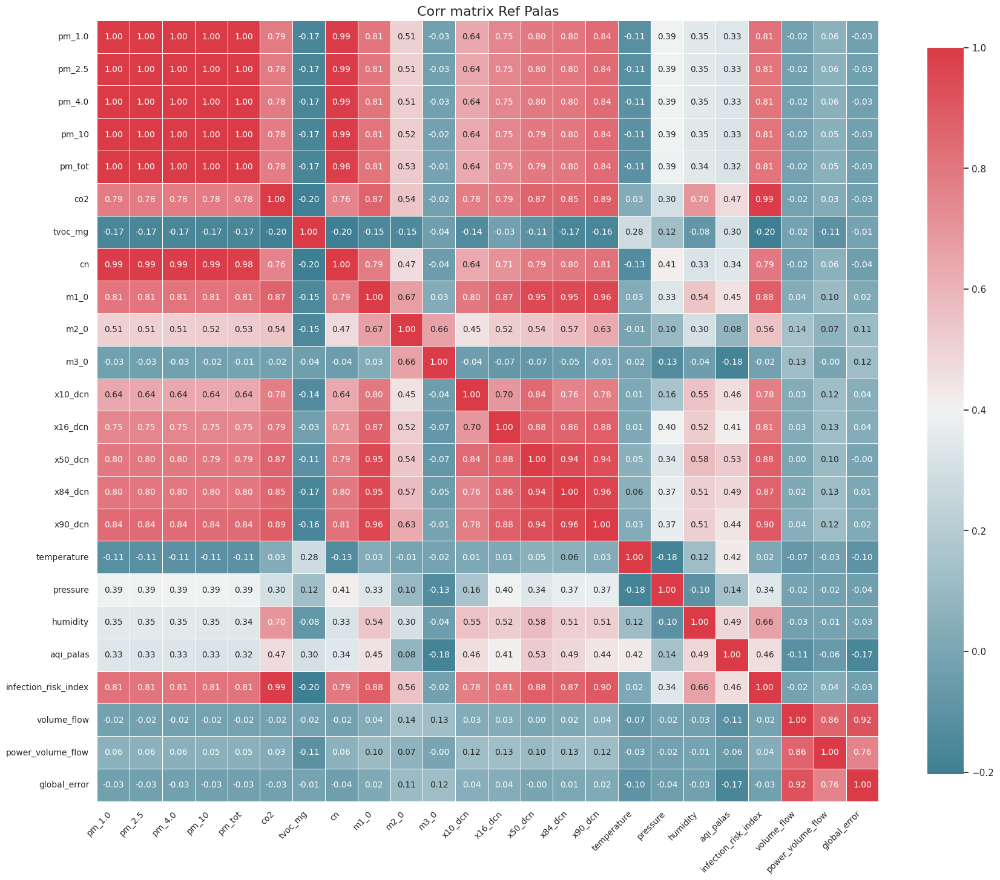

Index(['pm_1.0', 'pm_2.5', 'pm_4.0', 'pm_10', 'pm_tot', 'co2', 'tvoc_mg', 'cn',
       'm1_0', 'm2_0', 'm3_0', 'x10_dcn', 'x16_dcn', 'x50_dcn', 'x84_dcn',
       'x90_dcn', 'temperature', 'pressure', 'humidity', 'aqi_palas',
       'infection_risk_index', 'volume_flow', 'power_volume_flow',
       'global_error', 'dcn'],
      dtype='object')

In [4]:
plot_correlation_matrix(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().corr(),title=f"Corr matrix Ref Palas")

df_ref.columns

## PAHs

### Time series plots

In [5]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['pm_10','pm_1.0','pm_4.0','pm_2.5','pm_tot'],max_value=100)


### Diff plot

In [6]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().diff(),col_names=['pm_10',],min_value=-20,max_value=20)

### diff percentage plot

In [7]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['pm_10'],max_value=100)

/tmp/ipykernel_2069360/3221952736.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## xx_dcn

In [8]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['x10_dcn','x16_dcn','x50_dcn','x84_dcn','x90_dcn'],max_value=0.35)

## CO2

### Time series

In [9]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['co2'])

### diff plot

In [10]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['co2'])

/tmp/ipykernel_2069360/3936128323.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## Temperature, Humidity, AQI palas and infection risk index

### time series plot

In [11]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['temperature','humidity','aqi_palas','infection_risk_index'])


### diff plot

In [12]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['aqi_palas','infection_risk_index'],max_value=150)

/tmp/ipykernel_2069360/2194526930.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## TVOC

### Timeseries

In [13]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['tvoc_mg'])

### diff plot

In [15]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['tvoc_mg'],max_value=400)

/tmp/ipykernel_2069360/1464888733.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## Overall analysis

In [16]:
diff_df = transform_diff_avg(df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean())
#diff_df.dropna(axis=1,inplace=True)
diff_df.drop(['pm_1.0','pm_2.5','pm_4.0','pm_tot','x10_dcn','x16_dcn','x50_dcn','x84_dcn','x90_dcn','global_error'],inplace=True)

/home/usr1_tt/collocation_study/notebooks/sensor/../../src/transform.py:16: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



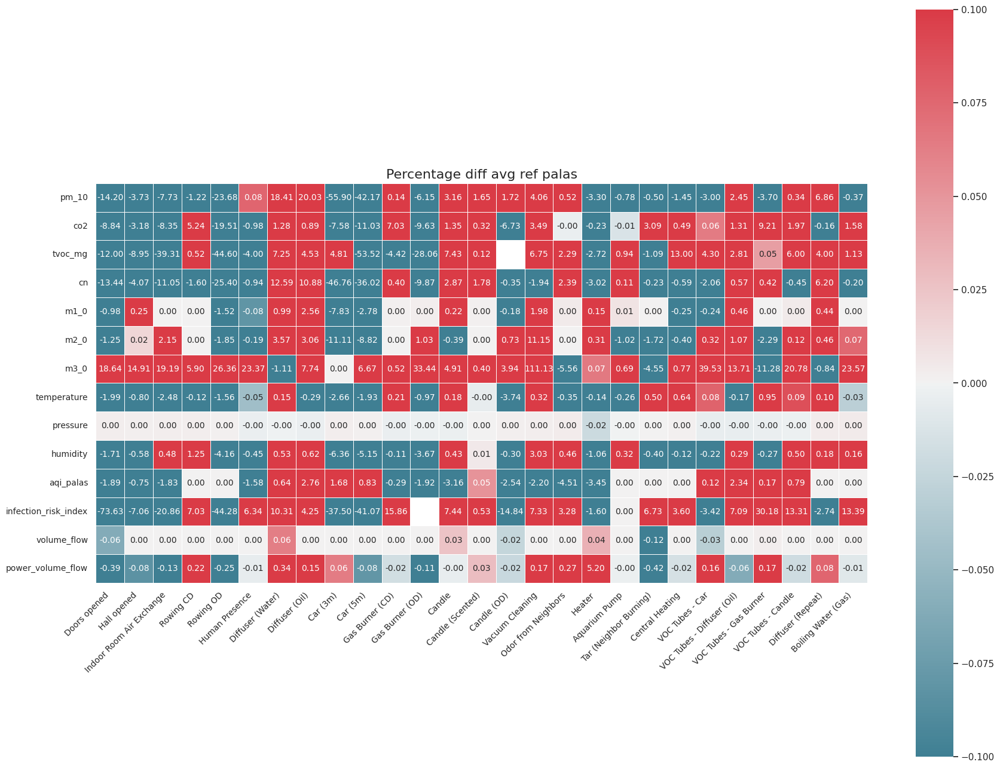

In [17]:
plot_correlation_matrix(diff_df,title="Percentage diff avg ref palas")